<a href="https://colab.research.google.com/github/juhang-lee/AI_VISION/blob/juhang-lee-patch-1/4_day/3.YOLOv5/YOLOv5.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!git clone https://github.com/ultralytics/yolov5  # YOLOv5 레퍼지토리 clone

Cloning into 'yolov5'...
remote: Enumerating objects: 16008, done.
remote: Counting objects: 100% (41/41), done.
remote: Compressing objects: 100% (28/28), done.
remote: Total 16008 (delta 22), reused 21 (delta 13), pack-reused 15967
Receiving objects: 100% (16008/16008), 14.68 MiB | 18.67 MiB/s, done.
Resolving deltas: 100% (10988/10988), done.


In [2]:
# 필요한 패키지 다운로드 및 임포트
%cd yolov5
%pip install -qr requirements.txt # install dependencies

import torch
import yaml
from IPython.display import Image, clear_output  # to display images

print(f"Setup complete. Using torch {torch.__version__} ({torch.cuda.get_device_properties(0).name if torch.cuda.is_available() else 'CPU'})")

/content/yolov5
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 190.6/190.6 kB 4.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 644.5/644.5 kB 8.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 7.5 MB/s eta 0:00:00
Setup complete. Using torch 2.1.0+cu118 (Tesla T4)


## 데이터셋 다운로드, yaml 파일 수정 - 각자 진행
- 사용하고자 하는 커스텀 데이터셋을 구글 드라이브에 'dataset'이라는 폴더에 업로드
- 'dataset' 폴더 안에는 학습/평가 데이터와 어노테이션(라벨) 그리고 데이터셋에 대한 설명이 담긴 yaml파일 필요

- Roboflow의 퍼블릭 데이터셋 사용
  - [roboflow 퍼블릭 데이터셋](https://public.roboflow.com/object-detection)에서 사용하고 싶은 데이터셋 다운로드해서 해당 폴더에 업로드
  - 여러 포맷으로 다운로드할 수 있는데 그 중에서 TXT - YOLOv5 PyTorch 로 다운로드

- 그 외 커스텀 데이터셋 사용
  - 다른 데이터셋이나 본인이 만든 데이터셋을 사용하고 싶다면 데이터, 라벨, yaml 파일을 모두 퍼블릭 데이터셋의 규격에 맞게 통일해줘야됨 (물론 코드 수정이 가능하다면 데이터셋 로딩하는 코드를 수정해도 됨)

- yaml 파일 수정
  - train, val(또는 test) 데이터가 있는 경로 수정 필요




In [3]:
!mkdir dataset
%cd dataset

/content/yolov5/dataset


In [4]:
!curl -L "https://public.roboflow.com/ds/ep0rIrKoRl?key=nCPKMJzrhV" > roboflow.zip

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   901  100   901    0     0   3231      0 --:--:-- --:--:-- --:--:--  3241
100 35.6M  100 35.6M    0     0  39.3M      0 --:--:-- --:--:-- --:--:-- 84.3M


In [5]:
!unzip roboflow.zip -d dronedata

Archive:  roboflow.zip
 extracting: dronedata/test/images/DJI_0267_JPG.rf.659fc518abe4994a0a04b681103029cc.jpg  
 extracting: dronedata/test/images/DJI_0289_JPG.rf.7d2ce495fb2d3a19962e761e718c3a5e.jpg  
 extracting: dronedata/test/images/DJI_0267_JPG.rf.12b4ae5e9e4ac08da13f17c5e555fd8f.jpg  
 extracting: dronedata/test/images/DJI_0267_JPG.rf.0a39d3f51902b67bf0162fe19793d9aa.jpg  
 extracting: dronedata/test/images/DJI_0262_JPG.rf.8c378a23b8822f63a44ad24c8787fab3.jpg  
 extracting: dronedata/test/images/DJI_0316_JPG.rf.2406ceec1ba7c548483c4f2e33c674b9.jpg  
 extracting: dronedata/test/images/DJI_0312_JPG.rf.783c9643ea6b0f5cc51eff20b27af449.jpg  
 extracting: dronedata/test/images/DJI_0312_JPG.rf.544df0e3a7b2778052c9110942b032a7.jpg  
 extracting: dronedata/test/images/DJI_0262_JPG.rf.47ce7cf6d8e3e310ab9b2b5c15ebba72.jpg  
 extracting: dronedata/test/images/DJI_0262_JPG.rf.560b36a2e292c1b3dee7eae7e1f3fbf0.jpg  
 extracting: dronedata/test/images/DJI_0262_JPG.rf.5f24b2ccccf544d3bb0c3cb740

In [6]:
!ls dronedata

data.yaml  README.dataset.txt  README.roboflow.txt  test  train  valid


In [19]:
%pwd
# %cd ..
# %pwd

'/content/yolov5'

In [20]:
# 사용할 데이터셋 경로 및 데이터셋의 yaml 파일 경로 지정
data_dir = 'dataset/dronedata'
data_yaml = 'dataset/dronedata/data.yaml'

In [21]:
# 데이터셋 yaml 파일 확인
with open(data_yaml) as f:
    film = yaml.load(f, Loader=yaml.FullLoader)
    display(film)

{'names': ['boat', 'car', 'dock', 'jetski', 'lift'],
 'nc': 5,
 'test': 'dataset/dronedata/test/images',
 'train': 'dataset/dronedata/train/images',
 'val': 'dataset/dronedata/valid/images'}

In [22]:
# yaml 파일의 train, val 데이터가 있는 경로 수정 (기존 경로 -> 구글 드라이브에 저장된 경로로)
film['train'] = 'dataset/dronedata/train/images'
film['val'] = 'dataset/dronedata/valid/images'
film['test'] = 'dataset/dronedata/test/images'

with open(data_yaml, 'w') as f:
    yaml.dump(film, f)

print('변경된 yaml 파일 :')
with open(data_yaml) as f:
    film = yaml.load(f, Loader=yaml.FullLoader)
    display(film)

변경된 yaml 파일 :


{'names': ['boat', 'car', 'dock', 'jetski', 'lift'],
 'nc': 5,
 'test': 'dataset/dronedata/test/images',
 'train': 'dataset/dronedata/train/images',
 'val': 'dataset/dronedata/valid/images'}

# 4. YOLOv5 모델 학습
- 배치사이즈, 학습 에폭, 모델 사이즈 등을 선택하여 학습시킬 수 있음
- 학습 결과 중 베스트 모델이 저장됨 -> 모델 저장된 경로 확인 필수!
  - img: 입력 이미지 크기
  - batch: 배치 사이즈
  - epochs: 총 학습 에폭
  - data: 데이터셋 yaml 파일 경로
  - weights: 모델 웨이트 경로(pre-train된 모델로 학습시키기 때문에)
  - cache: 캐시 이미지

In [ ]:
%cd ..

In [23]:
!python train.py --img 416 --batch 16 --epochs 150 --data {data_yaml} --weights yolov5s.pt --cache

train: weights=yolov5s.pt, cfg=, data=dataset/dronedata/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=150, batch_size=16, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v7.0-227-ge4df1ec Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla T4, 15102MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0.015, hsv_s=

# 학습한 모델 테스트

In [24]:
# 테스트 이미지 경로
test_data_dir = film['test']

# 실험 번호 지정 - 진행한 실험이 저장된 경로 확인해서 기입! - runs/train/exp1 인지 exp2, exp3 인지 확인 후 아래 번호 지정
train_exp_num = 2

In [25]:
# !python detect.py --weights runs/train/exp{train_exp_num}/weights/best.pt --img 416 --conf 0.1 --source {test_data_dir}
!python detect.py --weights runs/train/exp/weights/best.pt --img 416 --conf 0.1 --source {test_data_dir}

detect: weights=['runs/train/exp/weights/best.pt'], source=dataset/dronedata/valid/images, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.1, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_csv=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-227-ge4df1ec Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model summary: 157 layers, 7023610 parameters, 0 gradients, 15.8 GFLOPs
image 1/105 /content/yolov5/dataset/dronedata/valid/images/DJI_0259_JPG.rf.0b45fb1a66b01160e062152605a3c143.jpg: 320x416 2 docks, 2 lifts, 71.2ms
image 2/105 /content/yolov5/dataset/dronedata/valid/images/DJI_0259_JPG.rf.1dd765fa322e8c82fb336c18c03339ae.jpg: 320x416 2 docks, 1 jetski, 2 lifts, 5.9ms
image 3/105 /conten

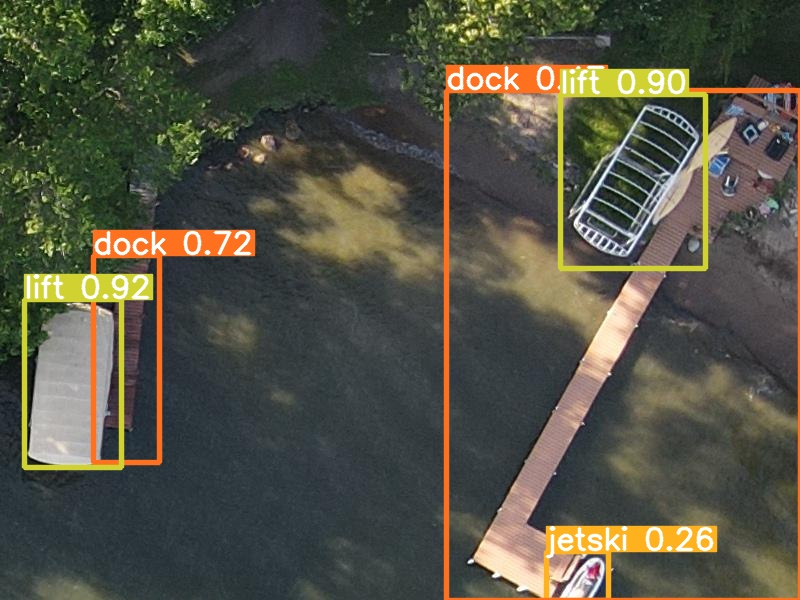

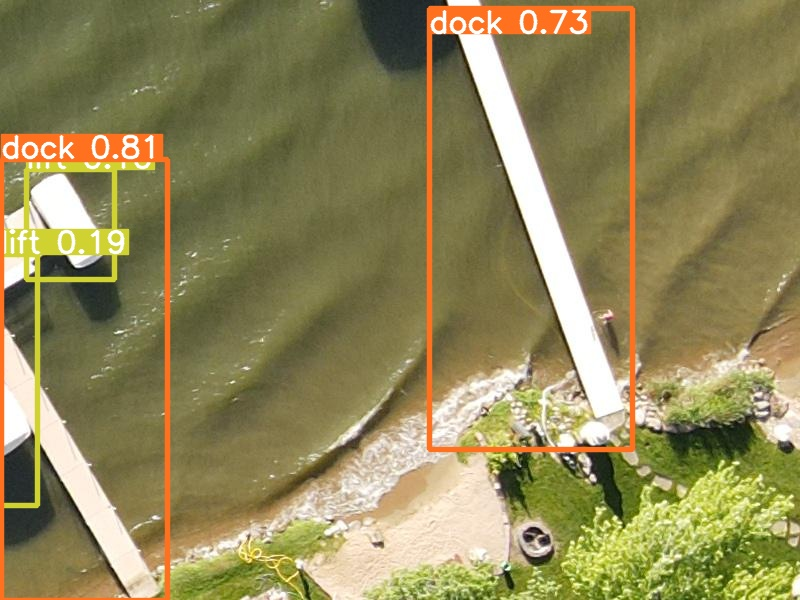

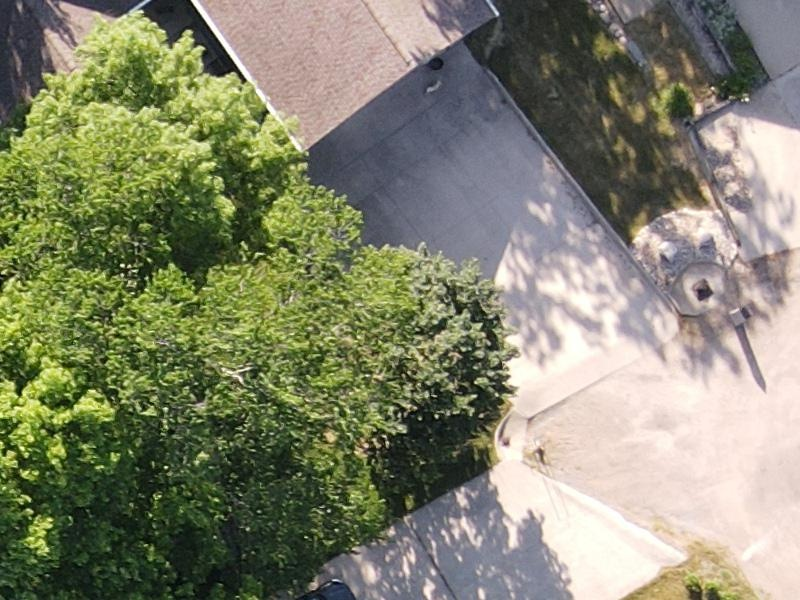

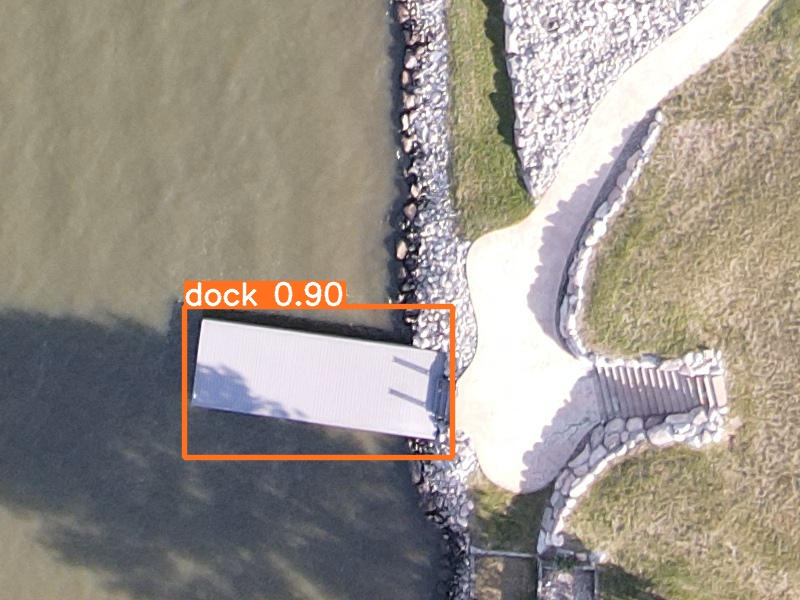

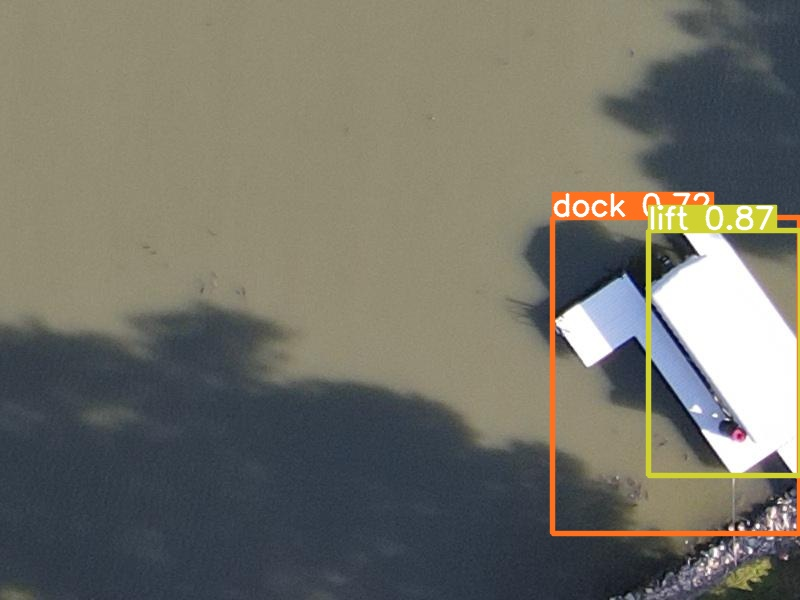

...

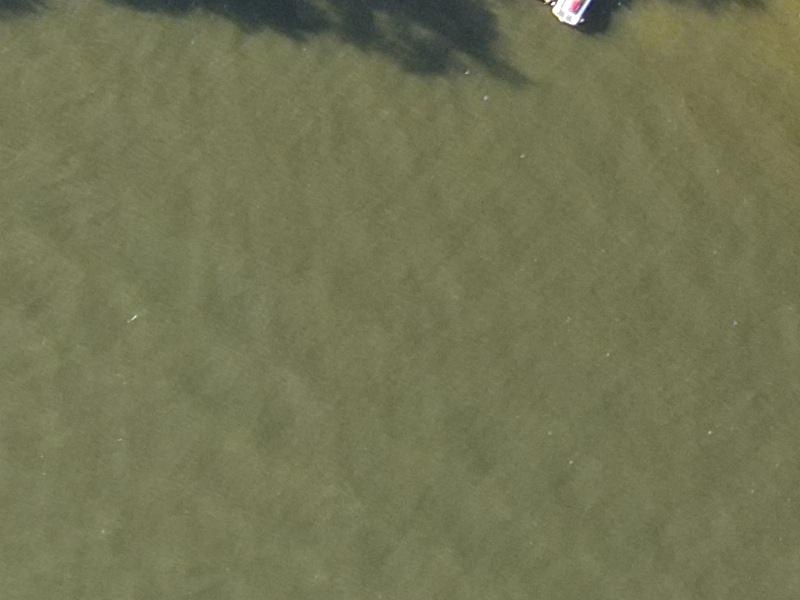

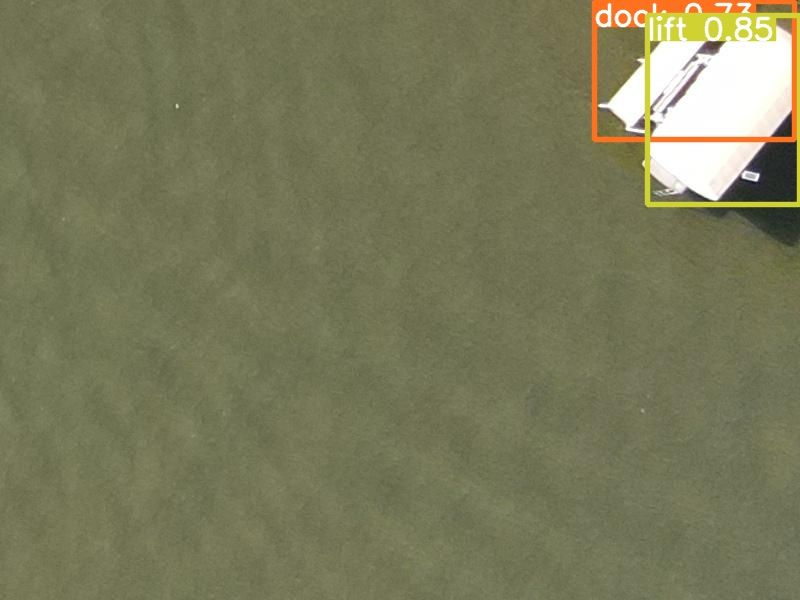

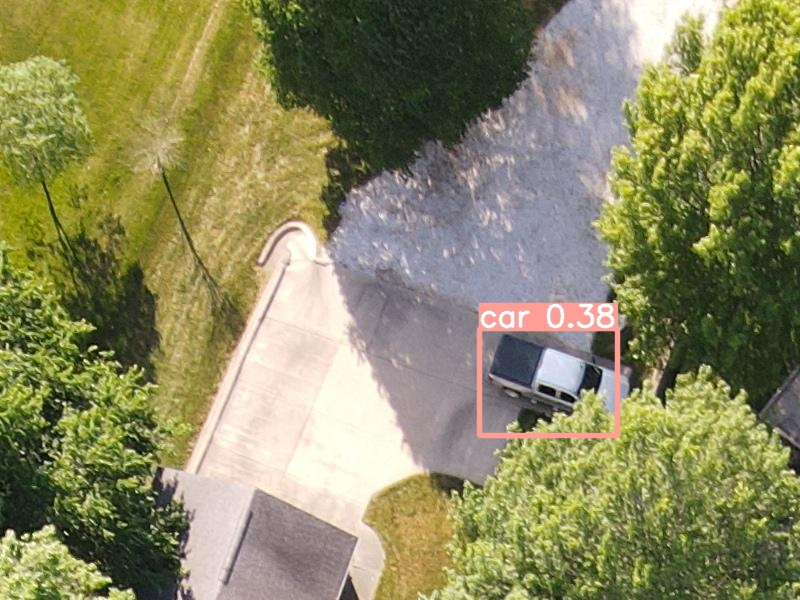

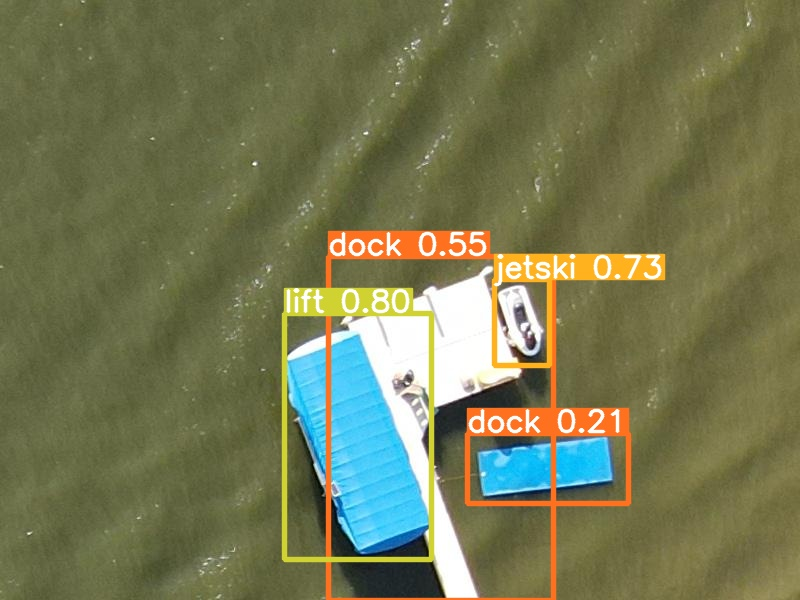

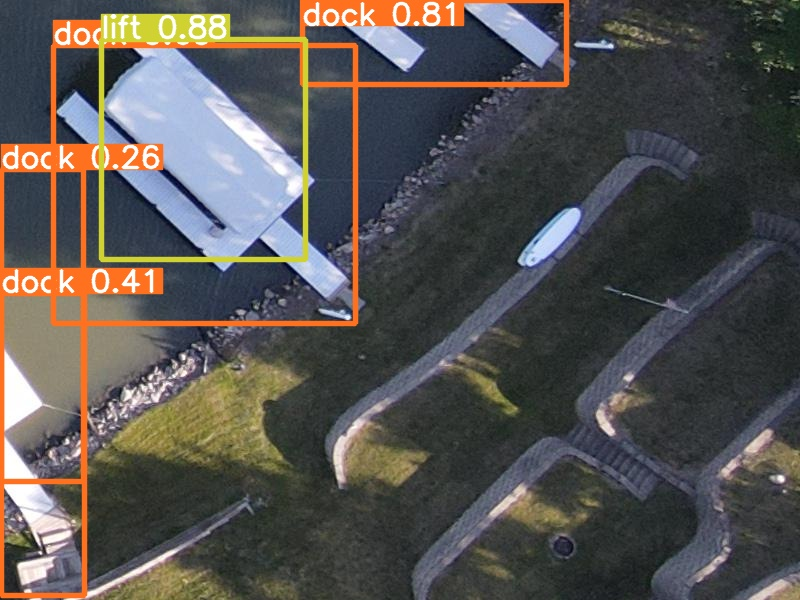

In [26]:
# 테스트 결과 확인해보기

import glob
import os
from IPython.display import Image, display

# test_exp_num = 2
test_exp_num = ''

if not os.path.exists('runs/detect/exp' + str(test_exp_num) + '/') :
  raise Exception('test_exp_num 을 다시 확인하세요.')

for imageName in glob.glob('runs/detect/exp' + str(test_exp_num) + '/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")